#### Show image

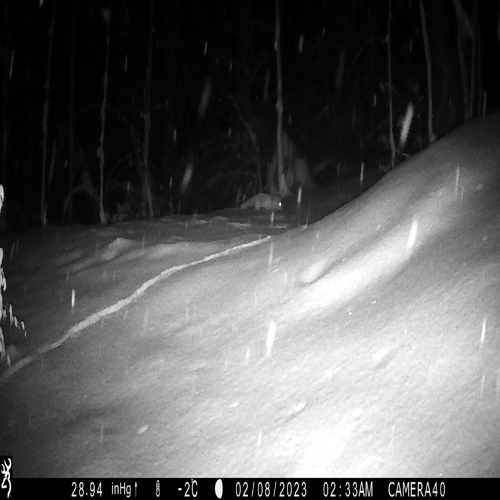

In [12]:
from utils.image import show_picture
from utils.cropping import crop_normalized_bbox, crop_normalized_bbox_square

image_path = '../pictures/04_ZYNDRANOWA/R/Zima/2/2023-02-08 02-33-53.JPG'
bbox = [0.49, 0.3828, 0.0761, 0.0441]
img = show_picture(image_path)
img

In [13]:
crop_normalized_bbox(img, bbox)

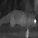

In [14]:
crop_normalized_bbox_square(img, bbox)

#### Load model

In [ ]:
import torch

from fine_tuning.speciesnet_head.speciesnet_polish_model import get_model, predict
from utils.detector import Detector

In [ ]:
torch.cuda.is_available()

True

In [ ]:
model, class_names = get_model()

In [ ]:
PICTURES_PATH = '../pictures/'
PICTURE_SUBPATH = '01_CZARNE/B/Lato/3/'
IMAGE_PATH = PICTURES_PATH + PICTURE_SUBPATH + '2023-07-19 05-18-16.JPG'
detector = Detector(dfyolo_weights='deepfaune/models/deepfaune-yolov8s_960.pt')

croppedimage, category, box, count, humanboxes = detector.bestBoxDetection(IMAGE_PATH)
if croppedimage is None:
    raise ValueError()
predict(model, croppedimage, class_names)

Using deepfaune-yolov8s_960 with weights at deepfaune/models/deepfaune-yolov8s_960.pt, in resolution 960x960 on cuda


ValueError: 

In [ ]:
croppedimage

### How much confidence is enough?

In [ ]:
import pandas as pd
from utils.unification import unify_speciesnet_results
from utils.image import show_picture
pd.set_option('display.max_colwidth', None)

In [ ]:
og = pd.read_csv('y_clean_thin.csv', index_col=0).rename(columns={'image_path': 'image'})
og.image = '../' + og.image

speciesnet = pd.read_csv('results/speciesnet/results_speciesnet_2025_11_22_11_21.csv', index_col=0)
speciesnet = unify_speciesnet_results(speciesnet)

merged = og.merge(speciesnet, on='image')
merged_ne = merged[~((merged.detected_animal == 'empty') & (merged.species != 'empty'))]

In [ ]:
wrong = merged_ne[merged_ne.species != merged_ne.detected_animal]

In [ ]:
wrong[wrong.confidence < 0.3]

,image,species,detected_animal,confidence
136,../../pictures/01_CZARNE/R/Lato/2/2023-07-18 04-58-02.JPG,red deer,bird,0.212466
189,../../pictures/01_CZARNE/R/Późna jesień/3/2022-11-27 16-21-52.JPG,wild boar,raccoon dog,0.269457
190,../../pictures/01_CZARNE/R/Późna jesień/3/2022-11-27 16-22-01.JPG,wild boar,fallow deer,0.289050
228,../../pictures/01_CZARNE/R/Późna jesień/3/2022-11-27 16-27-08.JPG,wild boar,other,0.292294
325,../../pictures/01_CZARNE/R/Wiosna/1/2023-05-14 04-26-18.JPG,wild boar,squirrel,0.284260
...,...,...,...,...
17615,../../pictures/29_STARACHOWICE/B/Wiosna/3/2023-05-29 05-25-42.JPG,other,marten,0.162396
17915,../../pictures/30_SUCHEDNIÓW/B/Wiosna/2/2023-04-27 13-57-02.JPG,moose,other,0.223046
17980,../../pictures/30_SUCHEDNIÓW/R/Lato/3/2023-07-23 03-50-24.JPG,marten,other,0.157491
18003,../../pictures/30_SUCHEDNIÓW/R/Wczesna jesień/1/2022-10-13 05-49-57.JPG,wild boar,other,0.211560


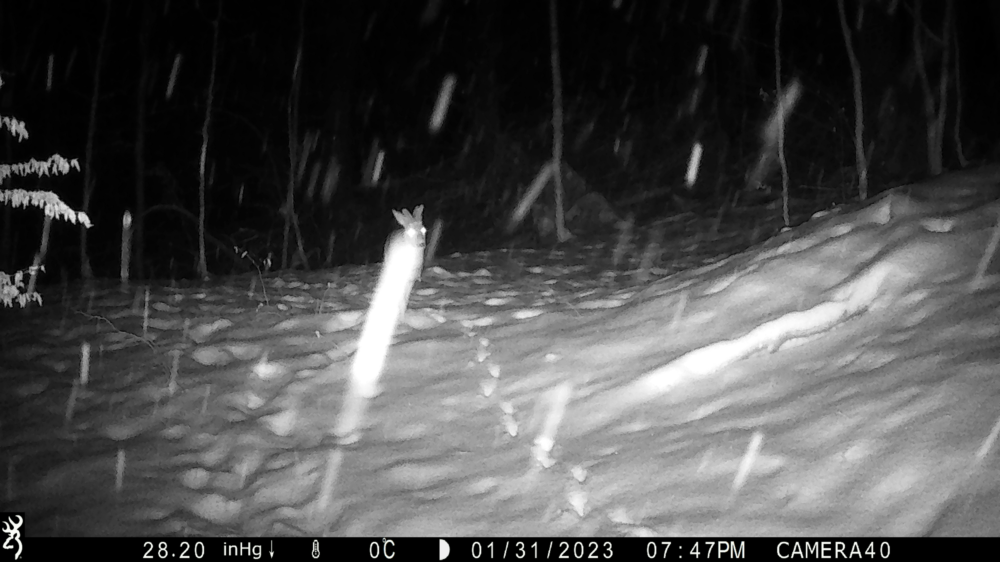

In [ ]:
image_path = '../pictures/04_ZYNDRANOWA/R/Zima/2/2023-01-31 19-47-33.JPG'
show_picture(image_path)

### ETC

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('deepfaune/results/results_deepfaune2025_11_05_13_58.csv', index_col=0)
md = pd.read_csv('results/speciesnet_head/results_speciesnet_head_2025_11_21_10_03.csv', index_col=0)
mds = pd.read_csv(r'results\speciesnet_head\results_square_speciesnet_head_2025_11_21_12_42.csv', index_col=0)

In [ ]:
(df.detected_animal == 'empty').sum()

np.int64(8027)

In [ ]:
(md.detected_animal == 'empty').sum()

np.int64(4435)

In [ ]:
(mds.detected_animal == 'empty').sum()

np.int64(4435)

### Bear retrain

In [8]:
import os
import ast

import pandas as pd
# from megadetector.detection.run_detector_batch import load_and_run_detector_batch

from utils.cropping import crop_normalized_bbox_square, crop_normalized_bbox
from utils.image import show_picture

In [2]:
batch_size = 24
file_names = [f for f in os.listdir('bear_retrain') if os.path.isfile(os.path.join('bear_retrain', f))]
images_paths = ['bear_retrain/' + file_name for file_name in file_names]

In [ ]:
# results = load_and_run_detector_batch(
#        "MDV5A", images_paths, confidence_threshold=0.2, batch_size=batch_size, n_cores=12)

Model v5a.0.1 already exists and is valid at /tmp/megadetector_models/md_v5a.0.1.pt
PyTorch reports 1 available CUDA devices
GPU available: True
PyTorch reports 1 available CUDA devices
GPU available: True


/media/plk/TOSHIBA EXT/mgr/.venv/lib/python3.12/site-packages/yolov5/utils/general.py:31: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources as pkg


Loading PT detector with compatibility mode classic
Loaded image size 1280 from model metadata
Using model stride: 64
PTDetector using device cuda:0


Fusing layers... 
Fusing layers... 
Model summary: 733 layers, 140054656 parameters, 0 gradients, 208.8 GFLOPs
Model summary: 733 layers, 140054656 parameters, 0 gradients, 208.8 GFLOPs


Loaded model in 2.58 seconds


100%|██████████| 60/60 [03:56<00:00,  3.93s/it]


In [4]:
images_paths_sec, categories, confs, bboxes, n_animals = [], [], [], [], []

for result in results:
    images_paths_sec.append(result.get('file'))
    
    detections = result.get('detections')
    if detections:
        detection = max(detections, key=lambda d: d["conf"])
        categories.append(detection.get('category'))
        confs.append(detection.get('conf'))
        bboxes.append(detection.get('bbox'))
        n_animals.append(len(detections))
    else:
        categories.append(None)
        confs.append(None)
        bboxes.append(None)
        n_animals.append(0)

results_df = pd.DataFrame({'image_path': images_paths_sec, 'category': categories, 'conf': confs, 'bbox': bboxes, 'n_animals': n_animals})
results_df.to_csv('bear_retrain/bears_megadetector_reults.csv')

In [3]:
results_df = pd.read_csv('bear_retrain/bears_megadetector_reults.csv', index_col=0)
results_df.head(3)

,image_path,category,conf,bbox,n_animals
0,bear_retrain/ZIF8MRF1OPQR.jpg,1.0,0.891,"[0.0, 0.0, 0.97, 0.887]",1
1,bear_retrain/ZIRHDT2K4B2U.jpg,1.0,0.914,"[0.224, 0.054, 0.632, 0.9429]",1
2,bear_retrain/ZJEQK0YT67EB.jpg,1.0,0.940,"[0.0579, 0.0, 0.9419, 1.0]",1


In [17]:
i = 0
for _, row in results_df.iterrows():
    img_path = row['image_path']
    category = row['category']
    if category != 1:
        continue
    bbox = ast.literal_eval(row["bbox"])
    try:
        img = show_picture(img_path)
    except:
        print(f'Error in file {img_path}')
        continue
    img = crop_normalized_bbox_square(img, bbox)
    if img.size[0] > 150 and img.size[1] > 150:
        i += 1
        img.save(f'bear_retrain_clean/{i}.jpg')
    os.remove(img_path)

Error in file bear_retrain/ZIF8MRF1OPQR.jpg
Error in file bear_retrain/ZIRHDT2K4B2U.jpg
Error in file bear_retrain/ZJEQK0YT67EB.jpg
Error in file bear_retrain/ZJKJ5FG327NB.jpg
Error in file bear_retrain/ZKLQB6XAUNTO.jpg
Error in file bear_retrain/ZN0QA1Y6VIZA.jpg
Error in file bear_retrain/ZNT9ENS4BSIQ.jpg
Error in file bear_retrain/ZPDLD43G62WD.jpg
Error in file bear_retrain/ZPW5Q3PSWD9Y.jpg
Error in file bear_retrain/ZQ3NE68LCOEX.jpg
Error in file bear_retrain/ZQK4NDBB6KJM.jpg
Error in file bear_retrain/ZRGXPRA9DAUD.jpg
Error in file bear_retrain/ZSTTVCVOZGQI.jpg
Error in file bear_retrain/ZTHD7IPX9B55.jpg
Error in file bear_retrain/ZUPLXAASCCHP.jpg
Error in file bear_retrain/ZW7N6MQOTO5F.jpg
Error in file bear_retrain/ZX3Y6FH3V7H1.jpg
Error in file bear_retrain/ZXZ2NMRKMJY9.jpg
Error in file bear_retrain/ZY5GGOC8SOHN.jpg
Error in file bear_retrain/ZYNK1GVZWGAH.jpg
Error in file bear_retrain/ZZ27FR8MA9N4.jpg
Error in file bear_retrain/ZZCXNLXSO34X.jpg
Error in file bear_retrain/ZZSUF